<a href="https://colab.research.google.com/github/Dhev-Mugunddhan-A/Anomalous-sound-detection-mobilefacenet/blob/main/audio-processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import os
import matplotlib.pyplot as plt
import librosa, librosa.display
import IPython.display as ipd
import pandas as pd
import numpy as np

<h3>Code to download the DCASE 2023 dataset</h3>

In [1]:
#Creating the development directory
!mkdir -p development

In [ ]:
!cd ./development; for machine_type in bearing fan gearbox slider ToyCar ToyTrain valve; do wget "https://zenodo.org/record/7882613/files/dev_${machine_type}.zip"; unzip -qq "dev_${machine_type}.zip" > 'error.txt'; done

In [2]:
!mkdir -p additional_training

In [ ]:
!cd ./additional_training; for machine_type in bandsaw grinder shaker ToyDrone ToyNscale ToyTank Vacuum; do wget "https://zenodo.org/record/7830345/files/eval_data_${machine_type}_train.zip"; unzip -qq "eval_data_${machine_type}_train.zip" > 'error.txt'; done
"uses output '>' redirection  operator"

In [ ]:
#mounting the drive into the local directory
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#!unzip -qq "/content/drive/MyDrive/Deep_learning_anomalous_sound_detection/additional_training/*.zip" -d "additional_training"

In [ ]:
!unzip -qq "/content/drive/MyDrive/Deep_learning_anomalous_sound_detection/development/*.zip" -d "development"


7 archives were successfully processed.


In [ ]:
#!unzip -qq "/content/drive/MyDrive/Deep_learning_anomalous_sound_detection/evaluation/*.zip" -d "evaluation"

In [ ]:
toy_car_attributes = pd.read_csv(r"/content/development/ToyCar/attributes_00.csv")

In [ ]:
toy_car_attributes.head()

,file_name,d1p,d1v,d2p,d2v,d3p,d3v
0,ToyCar/train/section_00_source_train_normal_00...,car,B1,spd,31V,mic,1
1,ToyCar/train/section_00_source_train_normal_00...,car,B1,spd,31V,mic,1
2,ToyCar/train/section_00_source_train_normal_00...,car,B1,spd,31V,mic,1
3,ToyCar/train/section_00_source_train_normal_00...,car,B1,spd,31V,mic,1
4,ToyCar/train/section_00_source_train_normal_00...,car,B1,spd,31V,mic,1


In [ ]:
toy_car_attributes.tail(200)
#last 200 files on each folder contains the test data

,file_name,d1p,d1v,d2p,d2v,d3p,d3v
1000,ToyCar/test/section_00_source_test_anomaly_000...,car,B1,spd,31V,mic,1
1001,ToyCar/test/section_00_source_test_anomaly_000...,car,B1,spd,31V,mic,1
1002,ToyCar/test/section_00_source_test_anomaly_000...,car,B1,spd,34V,mic,1
1003,ToyCar/test/section_00_source_test_anomaly_000...,car,B1,spd,40V,mic,1
1004,ToyCar/test/section_00_source_test_anomaly_000...,car,B1,spd,31V,mic,1
...,...,...,...,...,...,...,...
1195,ToyCar/test/section_00_target_test_normal_0046...,car,E2,spd,37V,mic,2
1196,ToyCar/test/section_00_target_test_normal_0047...,car,E1,spd,37V,mic,2
1197,ToyCar/test/section_00_target_test_normal_0048...,car,E1,spd,37V,mic,2
1198,ToyCar/test/section_00_target_test_normal_0049...,car,E2,spd,37V,mic,2


In [ ]:
toy_car_attributes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_name  1200 non-null   object
 1   d1p        1200 non-null   object
 2   d1v        1200 non-null   object
 3   d2p        1200 non-null   object
 4   d2v        1200 non-null   object
 5   d3p        1200 non-null   object
 6   d3v        1200 non-null   int64 
dtypes: int64(1), object(6)
memory usage: 65.8+ KB


In [ ]:
toy_car_attributes['Anomaly'] = toy_car_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)

In [ ]:
toy_car_attributes['Anomaly'].value_counts()

0    1100
1     100
Name: Anomaly, dtype: int64

In [ ]:
toy_train_attributes = pd.read_csv(r'/content/development/ToyTrain/attributes_00.csv')
bearing_attributes = pd.read_csv(r'/content/development/bearing/attributes_00.csv')
fan_attributes = pd.read_csv(r'/content/development/fan/attributes_00.csv')
gearbox_attributes = pd.read_csv(r'/content/development/gearbox/attributes_00.csv')
slider_attributes = pd.read_csv(r'/content/development/slider/attributes_00.csv')
valve_attributes = pd.read_csv(r'/content/development/valve/attributes_00.csv')

In [ ]:
bearing_attributes['Anomaly'] = bearing_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)
toy_train_attributes['Anomaly'] = toy_train_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)
fan_attributes['Anomaly'] = fan_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)
gearbox_attributes['Anomaly'] = gearbox_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)
slider_attributes['Anomaly'] = slider_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)
valve_attributes['Anomaly'] = valve_attributes['file_name'].transform(lambda x:1 if(x.find("anomaly")!=-1) else 0)


In [ ]:
attributes_list = [toy_car_attributes,toy_train_attributes,bearing_attributes,fan_attributes,gearbox_attributes,slider_attributes,valve_attributes]

In [ ]:
for i in attributes_list:
  print(i.info())
  print(i.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_name  1200 non-null   object
 1   d1p        1200 non-null   object
 2   d1v        1200 non-null   object
 3   d2p        1200 non-null   object
 4   d2v        1200 non-null   object
 5   d3p        1200 non-null   object
 6   d3v        1200 non-null   int64 
 7   Anomaly    1200 non-null   int64 
dtypes: int64(2), object(6)
memory usage: 75.1+ KB
None
                                           file_name  d1p d1v  d2p  d2v  d3p  \
0  ToyCar/train/section_00_source_train_normal_00...  car  B1  spd  31V  mic   
1  ToyCar/train/section_00_source_train_normal_00...  car  B1  spd  31V  mic   
2  ToyCar/train/section_00_source_train_normal_00...  car  B1  spd  31V  mic   
3  ToyCar/train/section_00_source_train_normal_00...  car  B1  spd  31V  mic   
4  ToyCar/train/section_00_source_train_normal_0

In [ ]:
attributes = pd.concat(attributes_list,axis=0,ignore_index=True)

In [ ]:
train_attributes = pd.concat([i.iloc[:1000,:] for i in attributes_list],axis=0,ignore_index=True)

In [ ]:
train_attributes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7000 entries, 0 to 6999
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   file_name  7000 non-null   object 
 1   d1p        7000 non-null   object 
 2   d1v        7000 non-null   object 
 3   d2p        5000 non-null   object 
 4   d2v        5000 non-null   object 
 5   d3p        2000 non-null   object 
 6   d3v        2000 non-null   float64
 7   Anomaly    7000 non-null   int64  
dtypes: float64(1), int64(1), object(6)
memory usage: 437.6+ KB


In [ ]:
test_attributes = pd.concat([i.iloc[1000:,:] for i in attributes_list],axis=0,ignore_index=True)

In [ ]:
test_attributes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1400 entries, 0 to 1399
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   file_name  1400 non-null   object 
 1   d1p        1400 non-null   object 
 2   d1v        1400 non-null   object 
 3   d2p        1000 non-null   object 
 4   d2v        1000 non-null   object 
 5   d3p        400 non-null    object 
 6   d3v        400 non-null    float64
 7   Anomaly    1400 non-null   int64  
dtypes: float64(1), int64(1), object(6)
memory usage: 87.6+ KB


<h3><em> Time-Domain feature extraction and analysis for the audio files</em> </h3>

In [ ]:
for i in attributes_list:
  #print(str(i.head(1)["file_name"]))
  print(i.iloc[1001,0])

ToyCar/test/section_00_source_test_anomaly_0002_car_B1_spd_31V_mic_1.wav
ToyTrain/test/section_00_source_test_anomaly_0002_car_B1_spd_8_mic_1.wav
bearing/test/section_00_source_test_anomaly_0001_vel_8_loc_C.wav
fan/test/section_00_source_test_anomaly_0001_m-n_W.wav
gearbox/test/section_00_source_test_anomaly_0001_volt_1.5_wt_0.wav
slider/test/section_00_source_test_anomaly_0001_vel_300_ac_0.30.wav
valve/test/section_00_source_test_anomaly_0001_pat_01.wav


In [ ]:
#ran_files = train_attributes.sample(5,axis='index')['file_name']
ran_files_tr = [i.head(1).loc[0,"file_name"] for i in attributes_list]
ran_files_te = [i.iloc[1001,0] for i in attributes_list]
ran_files = ran_files_tr + ran_files_te

In [ ]:
print("Normal samples:",ran_files_tr,"\nAnomaly Samples:",ran_files_te)

Normal samples: ['ToyCar/train/section_00_source_train_normal_0001_car_B1_spd_31V_mic_1.wav', 'ToyTrain/train/section_00_source_train_normal_0001_car_B2_spd_7_mic_1.wav', 'bearing/train/section_00_source_train_normal_0000_vel_8_loc_B.wav', 'fan/train/section_00_source_train_normal_0000_m-n_X.wav', 'gearbox/train/section_00_source_train_normal_0000_volt_1.5_wt_150.wav', 'slider/train/section_00_source_train_normal_0000_vel_380_ac_0.03.wav', 'valve/train/section_00_source_train_normal_0000_pat_00.wav'] 
Anomaly Samples: ['ToyCar/test/section_00_source_test_anomaly_0002_car_B1_spd_31V_mic_1.wav', 'ToyTrain/test/section_00_source_test_anomaly_0002_car_B1_spd_8_mic_1.wav', 'bearing/test/section_00_source_test_anomaly_0001_vel_8_loc_C.wav', 'fan/test/section_00_source_test_anomaly_0001_m-n_W.wav', 'gearbox/test/section_00_source_test_anomaly_0001_volt_1.5_wt_0.wav', 'slider/test/section_00_source_test_anomaly_0001_vel_300_ac_0.30.wav', 'valve/test/section_00_source_test_anomaly_0001_pat_01.w

In [ ]:
ipd.Audio(os.path.join('development','ToyCar/train/section_00_source_train_normal_0001_car_B1_spd_31V_mic_1.wav'))

In [ ]:
ipd.Audio(os.path.join('development','ToyCar/test/section_00_source_test_anomaly_0002_car_B1_spd_31V_mic_1.wav'))

In [ ]:
#Load an audio file as a floating point time series with the native sampling rate
#duration of each file = 1/sr
loaded_filed = []
for i in ran_files:
  temp,sr = librosa.load((os.path.join('development',i)),sr=None)
  loaded_filed.append([temp,sr])
  dur_sam = 1/sr
  print(f"Duration of {i} audio's each sample is {dur_sam:.6f} seconds")
  print(f"Duration of {i} audio is {dur_sam*len(temp)} seconds")

Duration of ToyCar/train/section_00_source_train_normal_0001_car_B1_spd_31V_mic_1.wav audio's each sample is 0.000063 seconds
Duration of ToyCar/train/section_00_source_train_normal_0001_car_B1_spd_31V_mic_1.wav audio is 12.0 seconds
Duration of ToyTrain/train/section_00_source_train_normal_0001_car_B2_spd_7_mic_1.wav audio's each sample is 0.000063 seconds
Duration of ToyTrain/train/section_00_source_train_normal_0001_car_B2_spd_7_mic_1.wav audio is 12.0 seconds
Duration of bearing/train/section_00_source_train_normal_0000_vel_8_loc_B.wav audio's each sample is 0.000063 seconds
Duration of bearing/train/section_00_source_train_normal_0000_vel_8_loc_B.wav audio is 10.0 seconds
Duration of fan/train/section_00_source_train_normal_0000_m-n_X.wav audio's each sample is 0.000063 seconds
Duration of fan/train/section_00_source_train_normal_0000_m-n_X.wav audio is 10.0 seconds
Duration of gearbox/train/section_00_source_train_normal_0000_volt_1.5_wt_150.wav audio's each sample is 0.000063 se

In [ ]:
loaded_filed

[[array([0.01080322, 0.01675415, 0.01361084, ..., 0.0078125 , 0.00631714,
         0.00991821], dtype=float32),
  16000],
 [array([9.1552734e-05, 6.1035156e-04, 1.4343262e-03, ..., 1.8615723e-03,
         2.4719238e-03, 4.3945312e-03], dtype=float32),
  16000],
 [array([0.00216675, 0.00201416, 0.00015259, ..., 0.00930786, 0.0098877 ,
         0.00976562], dtype=float32),
  16000],
 [array([-0.02056885, -0.00671387, -0.00360107, ...,  0.00860596,
          0.01855469,  0.00064087], dtype=float32),
  16000],
 [array([ 0.00305176,  0.0043335 , -0.00057983, ...,  0.02850342,
          0.02810669,  0.01824951], dtype=float32),
  16000],
 [array([-0.00811768, -0.0055542 , -0.00308228, ..., -0.01141357,
         -0.00979614, -0.00753784], dtype=float32),
  16000],
 [array([-0.00622559, -0.00613403, -0.00735474, ..., -0.00836182,
         -0.00714111, -0.00430298], dtype=float32),
  16000],
 [array([ 0.01235962,  0.01852417,  0.02328491, ..., -0.02462769,
         -0.02423096, -0.02908325], dt

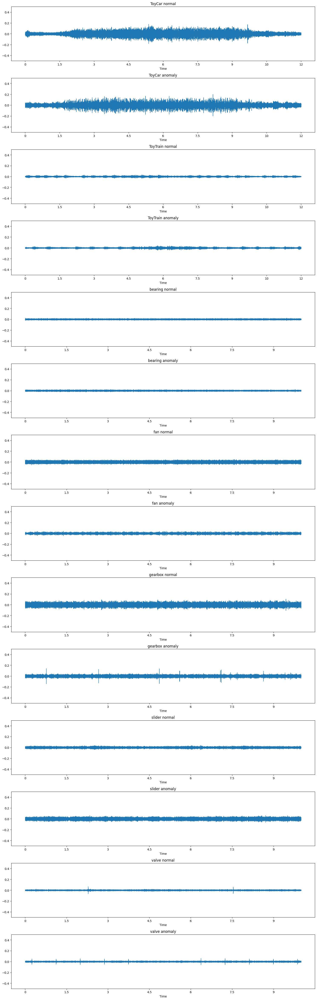

In [ ]:

plt.figure(figsize=(15, 47))

for i in range(1, 8):
    plt.subplot(14, 1, 2 * i - 1)
    librosa.display.waveshow(loaded_filed[i - 1][0], sr=loaded_filed[i - 1][1])
    plt.title((ran_files[i - 1].split('/'))[0] + " normal")
    plt.ylim((-0.5, 0.5))

    plt.subplot(14, 1, 2 * i)
    librosa.display.waveshow(loaded_filed[i + 6][0], sr=loaded_filed[i + 6][1])
    plt.title((ran_files[i + 6].split('/'))[0] + " anomaly")
    plt.ylim((-0.5, 0.5))
plt.tight_layout(pad=1.08)
plt.show()

In [ ]:
#calculate the amplitude envelope



<h3><em>Fourier transform</em></h3>

In [ ]:
loaded_filed[1]

[array([9.1552734e-05, 6.1035156e-04, 1.4343262e-03, ..., 1.8615723e-03,
        2.4719238e-03, 4.3945312e-03], dtype=float32),
 16000]

In [ ]:
ft=[]
for i in range(len(loaded_filed)):
  ft.append(np.fft.fft(loaded_filed[i][0]))

In [ ]:
# Each element in the array is a complex number which contains both the amplitude and phase information. But for plotting we are only interested in amplitude part, so we will remove the phase part.

ft[i]

array([-0.27957153+0.j        , -0.17812136-0.00207795j,
       -0.16635136+0.00019067j, ..., -0.19181893+0.01835041j,
       -0.16635136-0.00019067j, -0.17812136+0.00207795j])

In [ ]:
magnitude_ft = []
for i in range(len(ft)):
  magnitude_ft.append(np.abs(ft[i]))

In [ ]:
magnitude_ft[1].shape

(192000,)

In [ ]:
freq = [np.linspace(0,loaded_filed[i][1],magnitude_ft[i].shape[0]) for i in range(len(loaded_filed))]


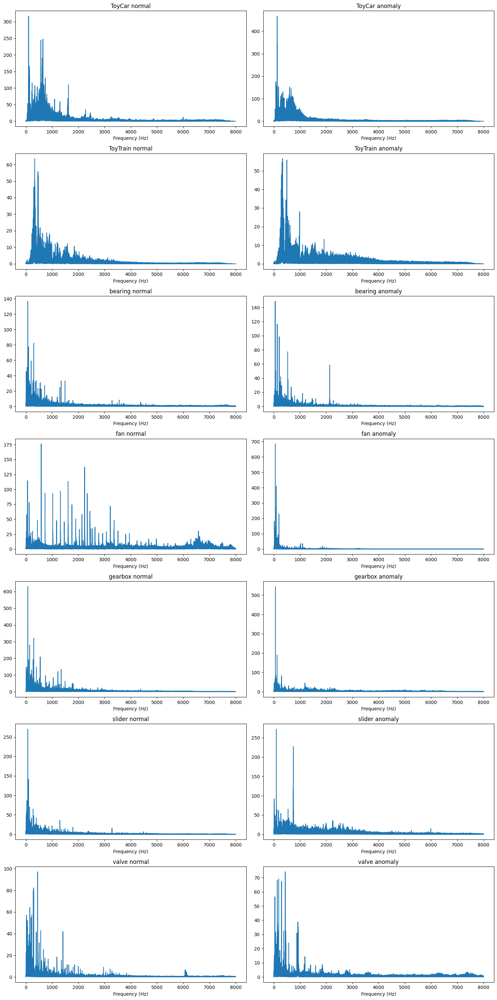

In [ ]:
plt.figure(figsize=(15,30))

for i in range(1, 8):
    plt.subplot(7, 2, 2 * i - 1)
    plt.plot(freq[i-1][:int(len(freq[i-1])*0.5)],magnitude_ft[i-1][:int(len(magnitude_ft[i-1])*0.5)])  #since fourier transform is symmnetric at nyquist frequency(sr/2)
    plt.title((ran_files[i - 1].split('/'))[0] + " normal")
    plt.xlabel("Frequency (Hz)")

    plt.subplot(7, 2, 2 * i)
    plt.plot(freq[i + 6][:int(len(freq[i-1])*0.5)],magnitude_ft[i + 6][:int(len(magnitude_ft[i-1])*0.5)])
    plt.title((ran_files[i + 6].split('/'))[0] + " anomaly")
    plt.xlabel("Frequency (Hz)")


plt.tight_layout(pad=1.08)
plt.show()

<h2><em>Extracting Spectrogram</em></h2>

In [ ]:
FRAME_SIZE = 2048
HOP_SIZE = 512



In [ ]:
#db-scaled spectrogram
def db_spec(x):
  signal,sr = librosa.load((os.path.join('development',x)),sr=None)
  spec = librosa.amplitude_to_db(librosa.stft(signal,n_fft = FRAME_SIZE,hop_length=HOP_SIZE))
  spec = np.abs(spec) **2
  return spec,sr


In [ ]:
#amplitude spectrogram
def amp_spec(x):
  signal,sr = librosa.load((os.path.join('development',x)),sr=None)
  spec = librosa.stft(signal,n_fft = FRAME_SIZE,hop_length=HOP_SIZE)
  spec = np.abs(spec) **2
  return spec,sr

In [ ]:
#log amplitude spectrogram
def log_amp_spec(x):
  signal,sr = librosa.load((os.path.join('development',x)),sr=None)
  spec = librosa.stft(signal,n_fft = FRAME_SIZE,hop_length=HOP_SIZE)
  spec = np.abs(spec) **2
  spec = librosa.power_to_db(spec)
  return spec,sr



In [ ]:
#code to visualize spectrogram
def plot_spectrogram(Y, sr, hop_length, y_axis="linear"):
    #plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y,
                             sr=sr,
                             hop_length=hop_length,
                             x_axis="time",
                             y_axis=y_axis)
    plt.colorbar(format="%+2.f")



<ipython-input-38-71443f3c6abd>:4: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  spec = librosa.amplitude_to_db(librosa.stft(signal,n_fft = FRAME_SIZE,hop_length=HOP_SIZE))


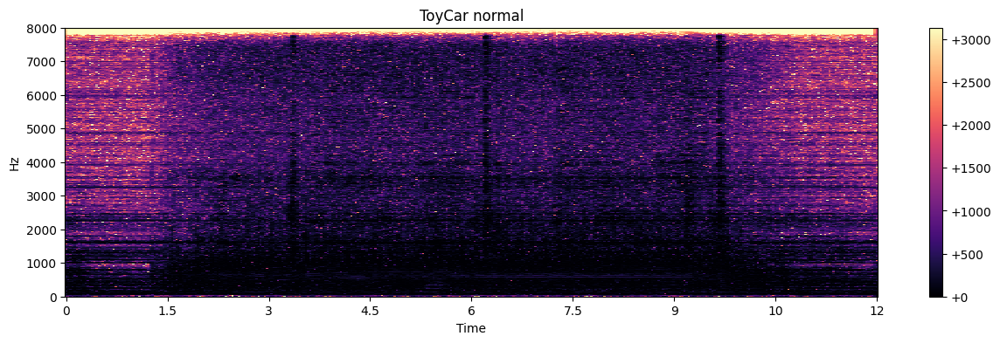

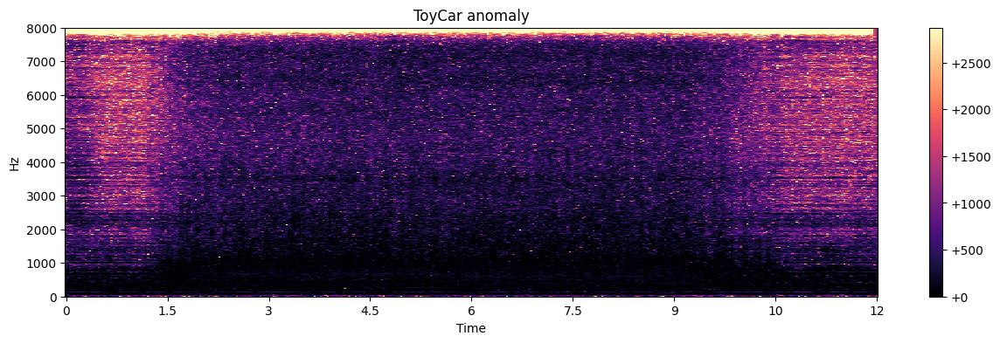

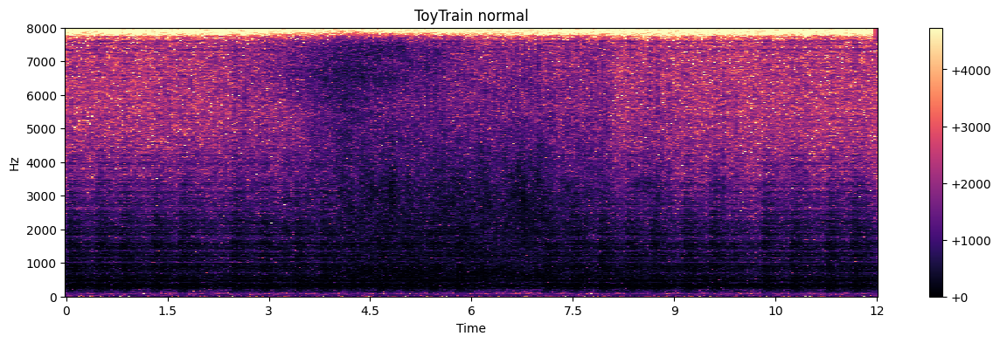

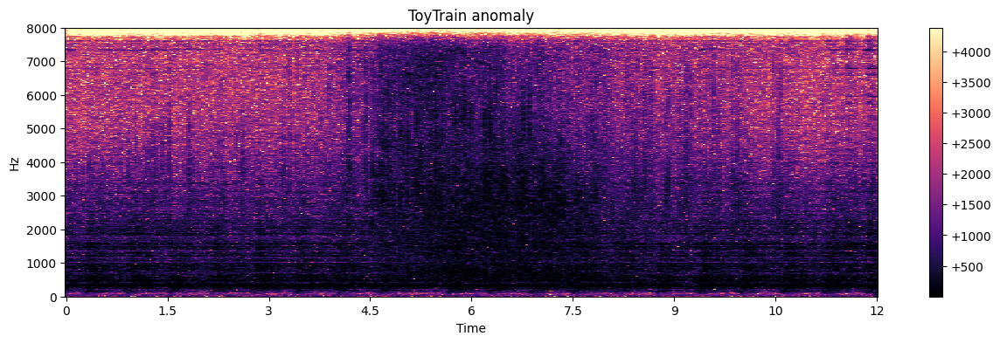

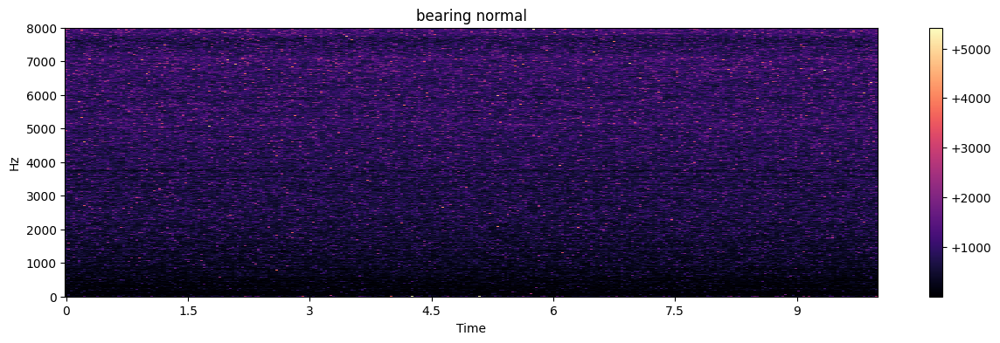

...

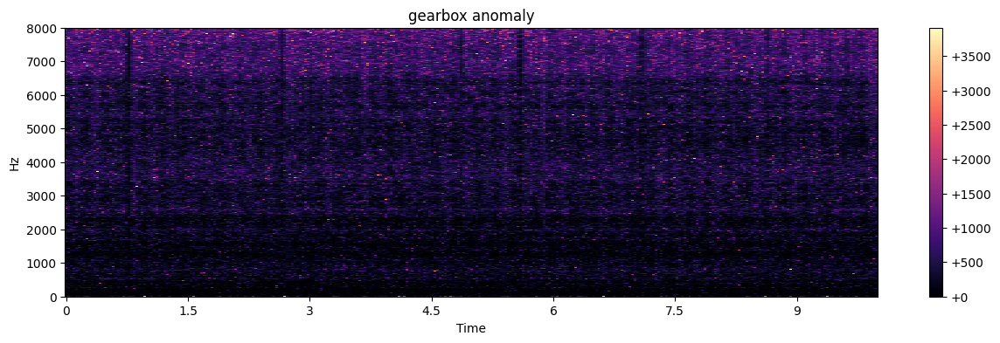

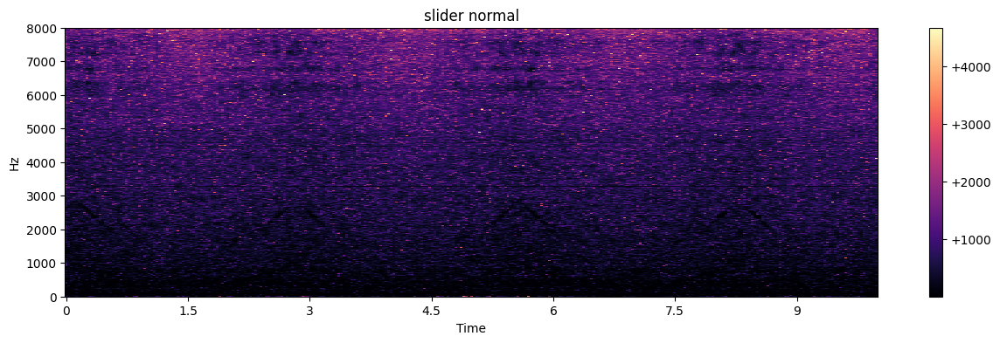

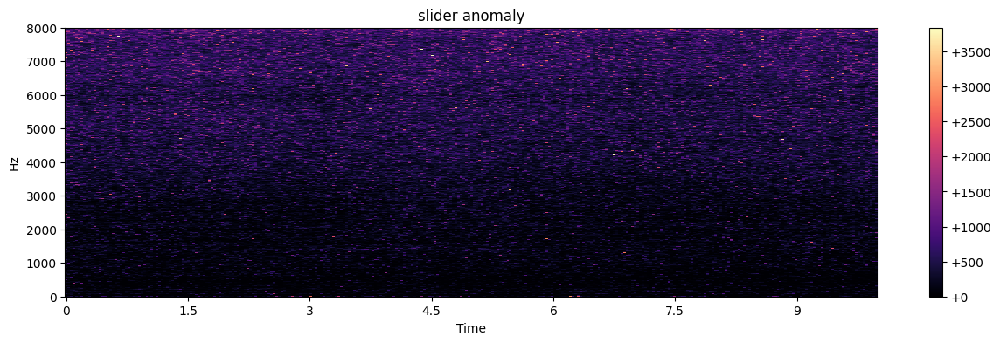

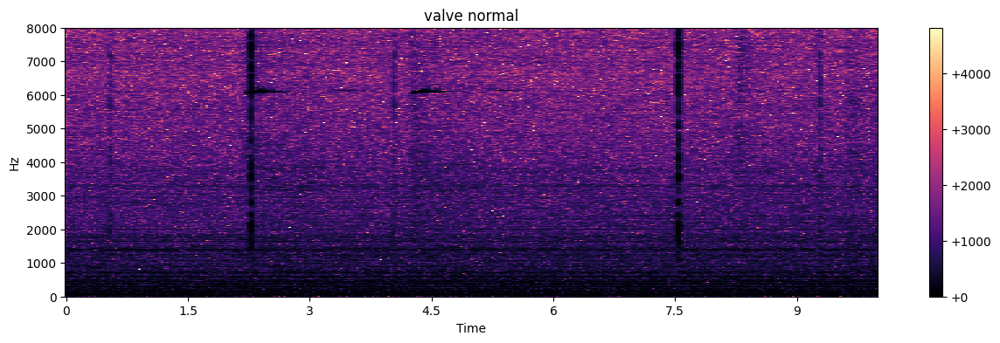

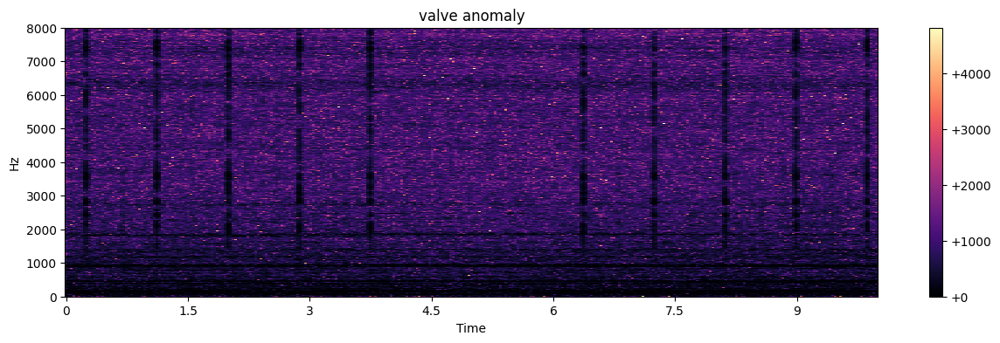

In [ ]:
#db-scaled spectrogram
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = db_spec(ran_files[i])
    title = (ran_files[i].split('/'))[0] + " normal"
    plot_spectrogram(Y, sr, HOP_SIZE)
    plt.title(title)

    plt.figure(figsize=(15,4))
    Y, sr = db_spec(ran_files[i + 7])
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    plot_spectrogram(Y, sr, HOP_SIZE)
    plt.title(title)
plt.show()
plt.close()

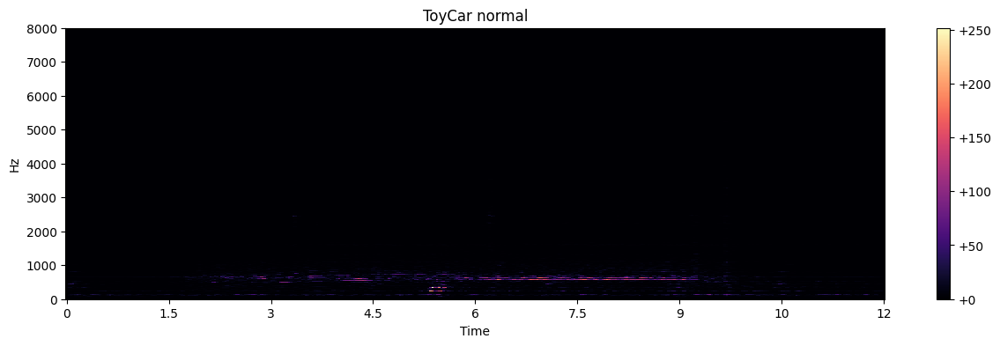

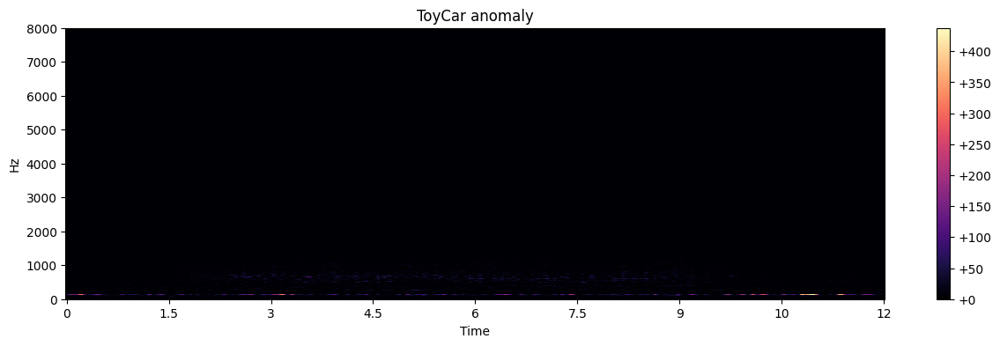

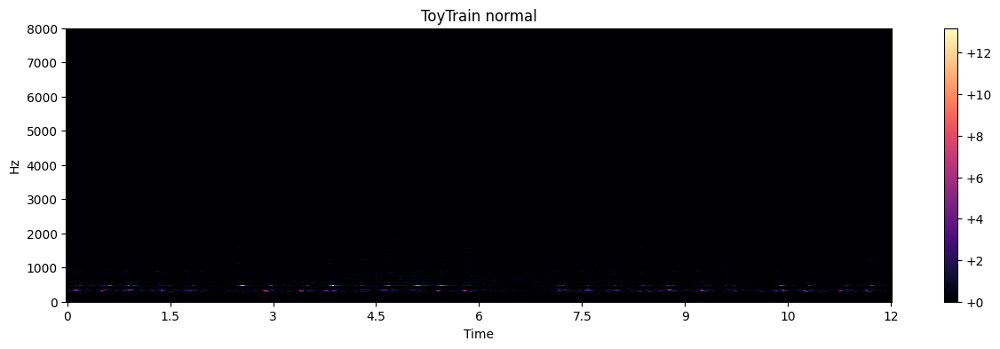

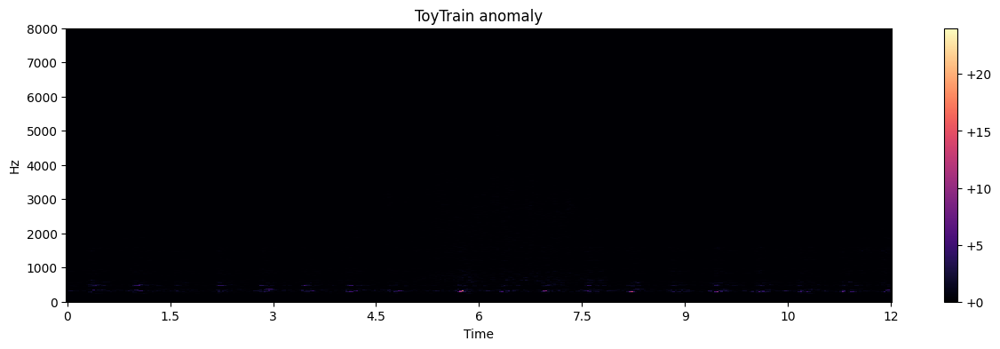

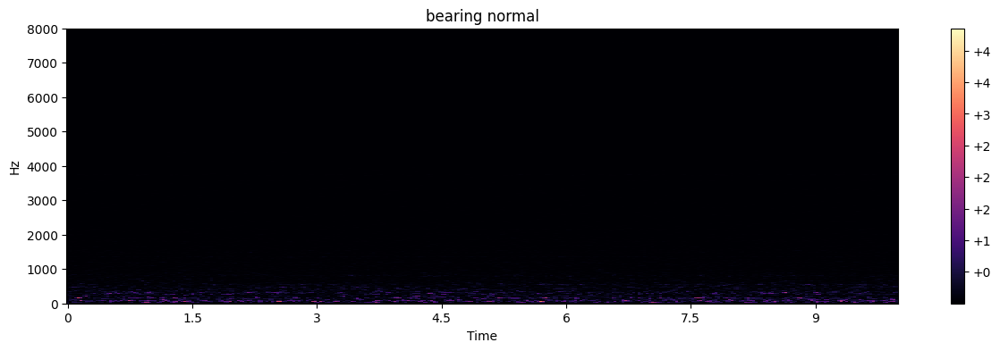

...

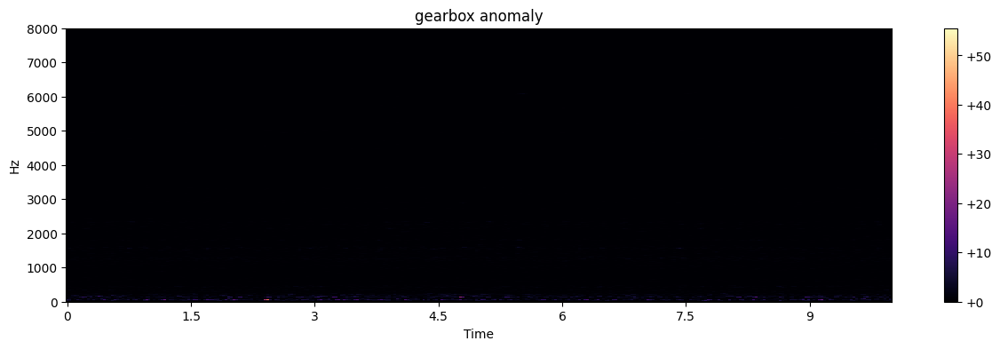

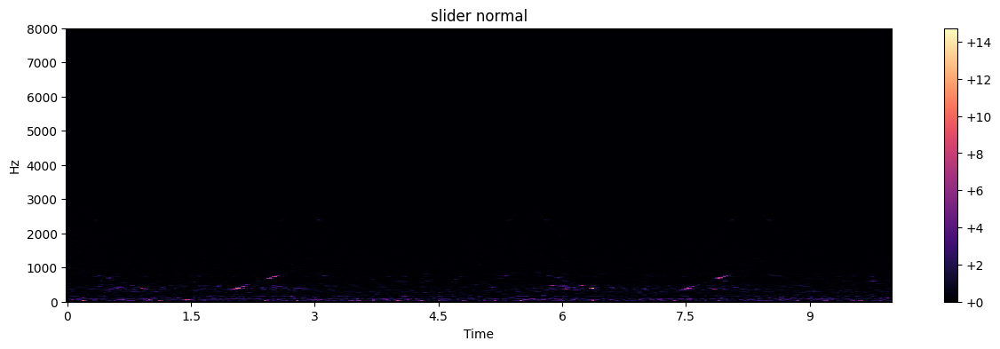

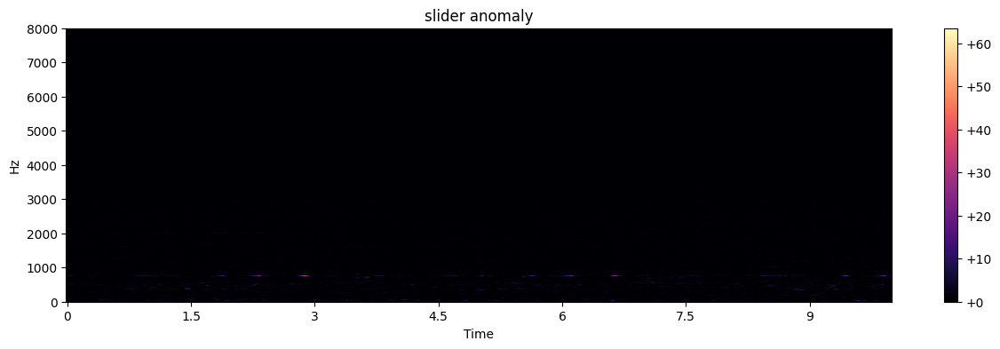

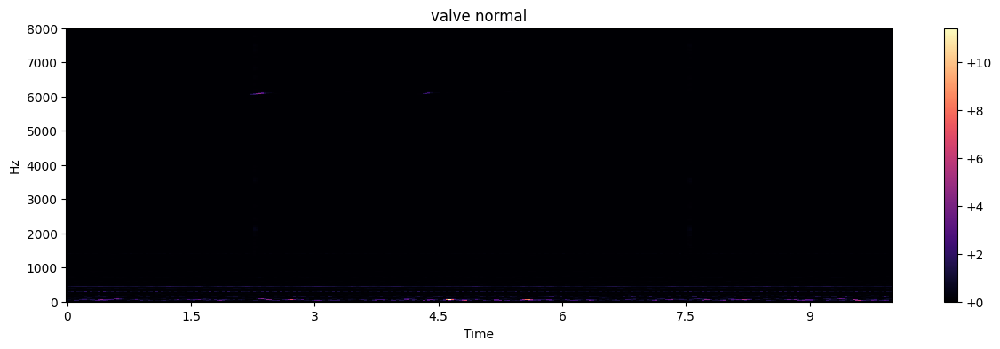

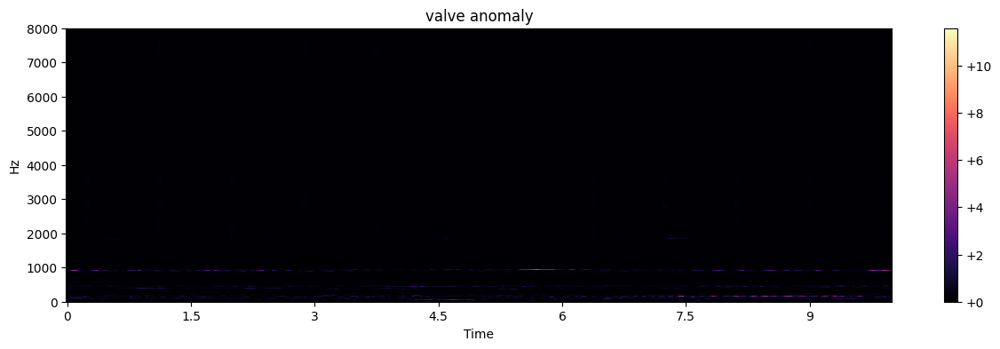

In [ ]:
#amplitude spectrogram
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = amp_spec(ran_files[i])
    title = (ran_files[i].split('/'))[0] + " normal"
    plot_spectrogram(Y, sr, HOP_SIZE)
    plt.title(title)

    plt.figure(figsize=(15,4))
    Y, sr = amp_spec(ran_files[i + 7])
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    plot_spectrogram(Y, sr, HOP_SIZE)
    plt.title(title)
plt.show()
plt.close()

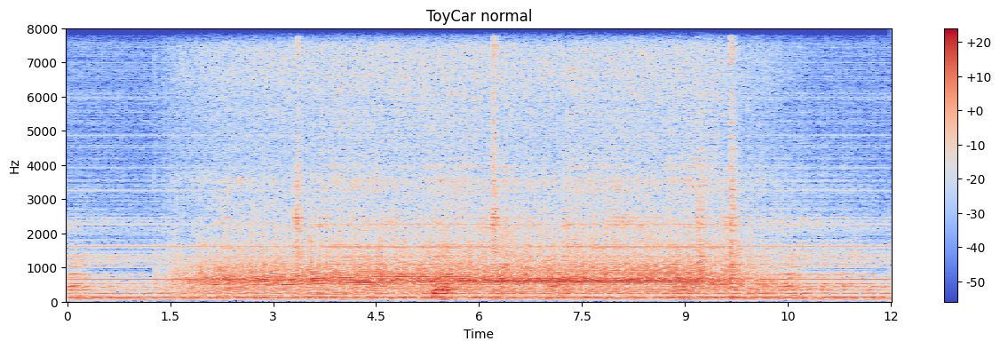

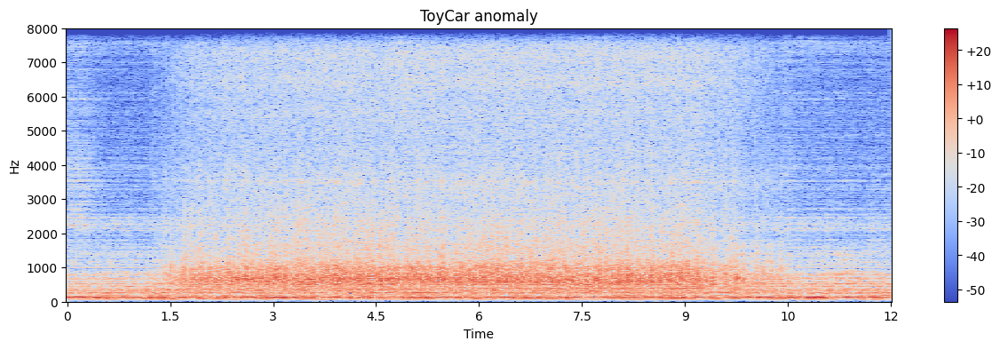

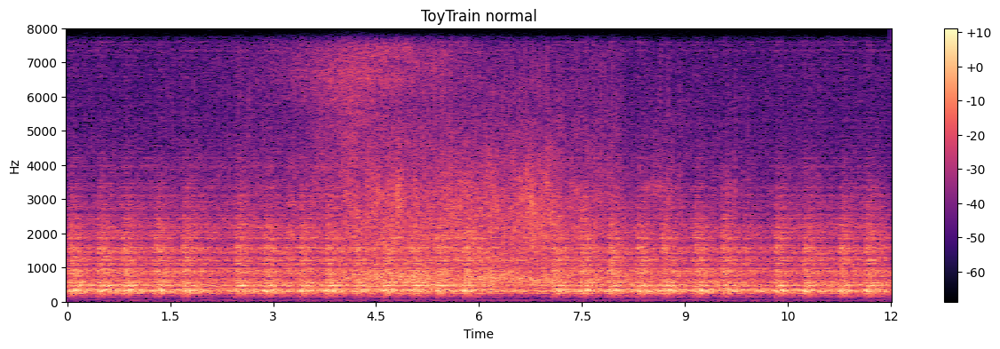

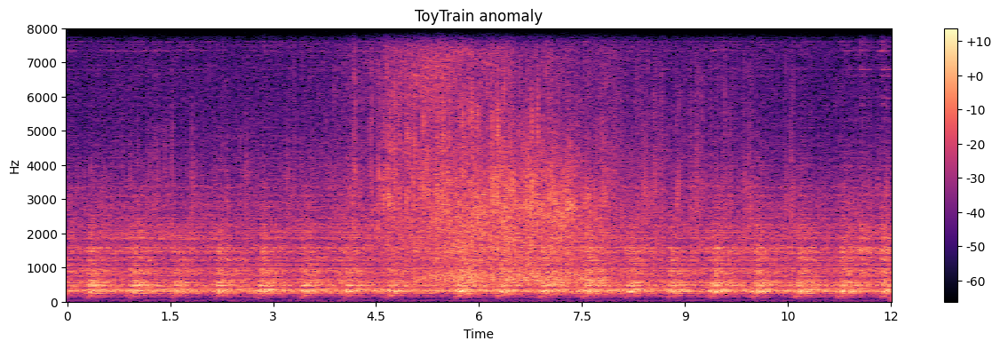

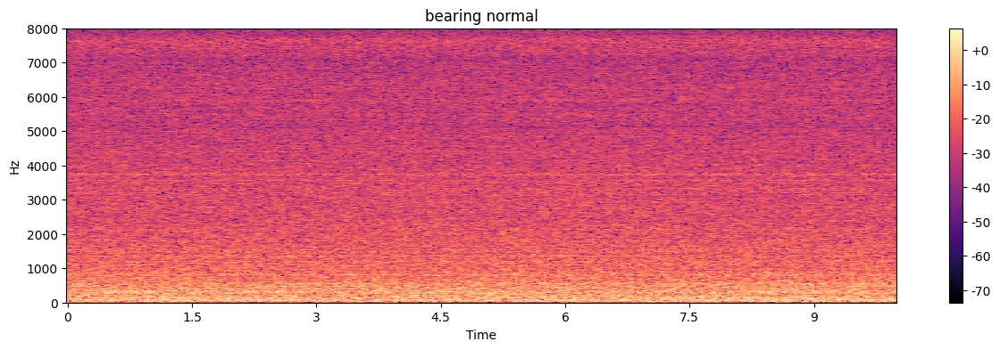

...

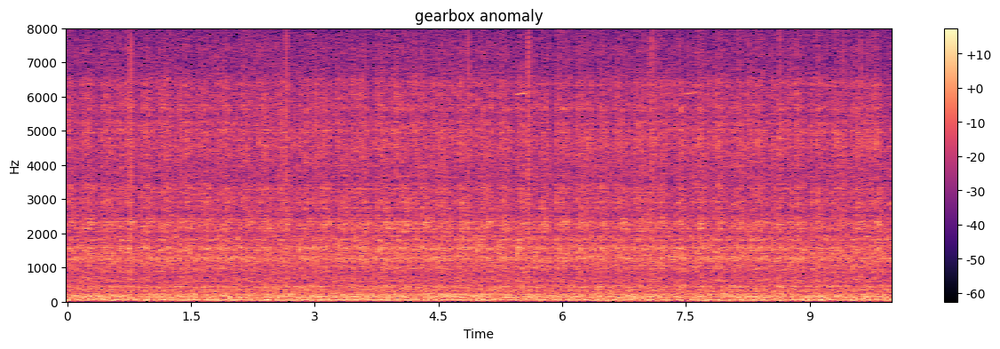

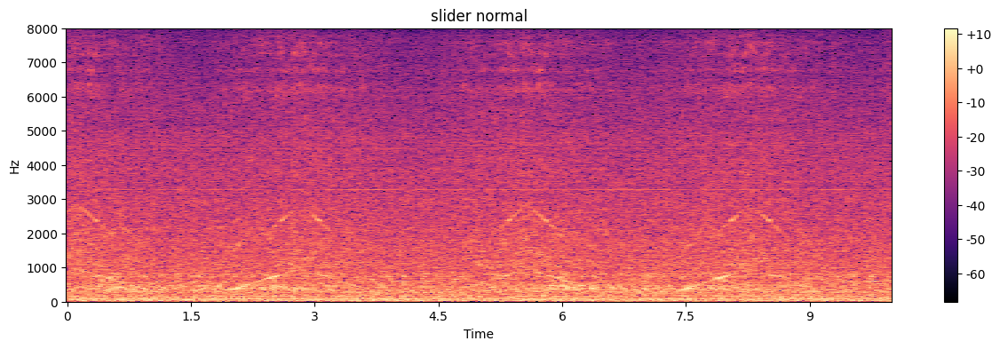

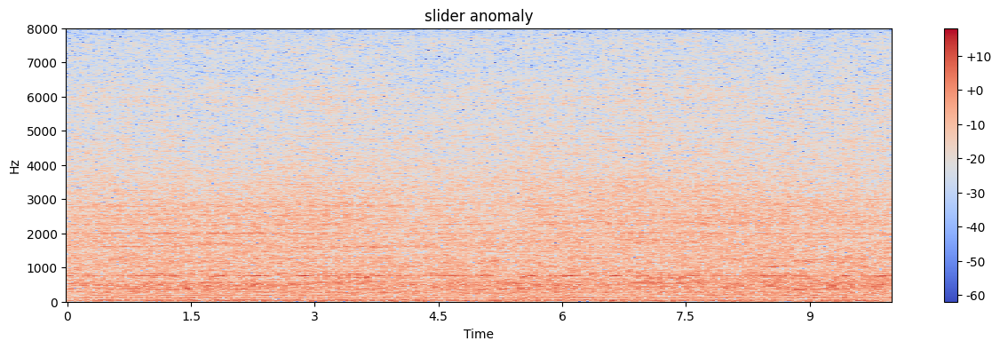

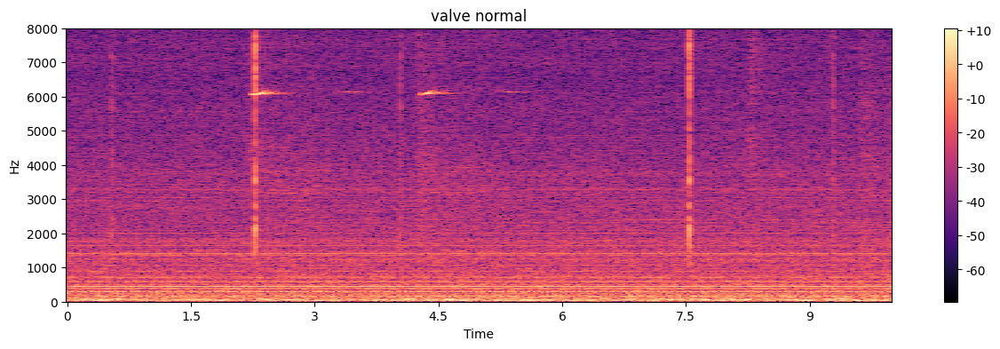

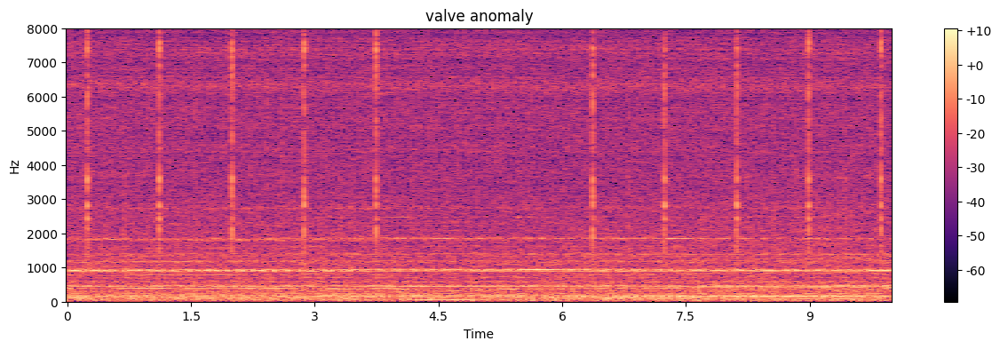

In [ ]:
#log amplitude spectrogram
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = log_amp_spec(ran_files[i])
    title = (ran_files[i].split('/'))[0] + " normal"
    plot_spectrogram(Y, sr, HOP_SIZE)
    plt.title(title)

    plt.figure(figsize=(15,4))
    Y, sr = log_amp_spec(ran_files[i + 7])
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    plot_spectrogram(Y, sr, HOP_SIZE)
    plt.title(title)
plt.show()
plt.close()

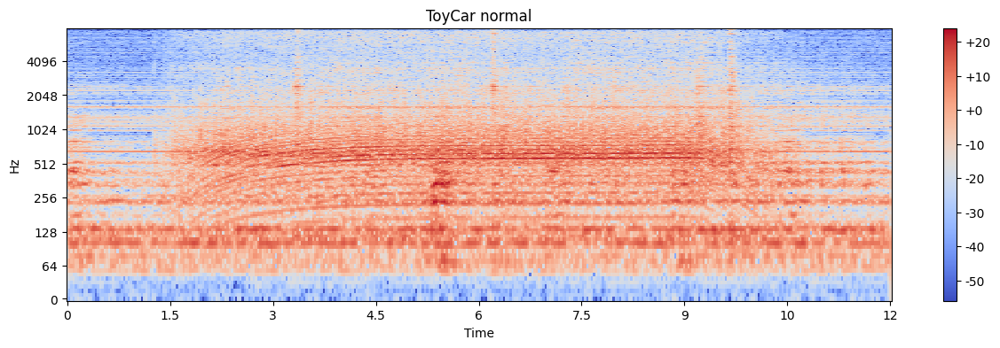

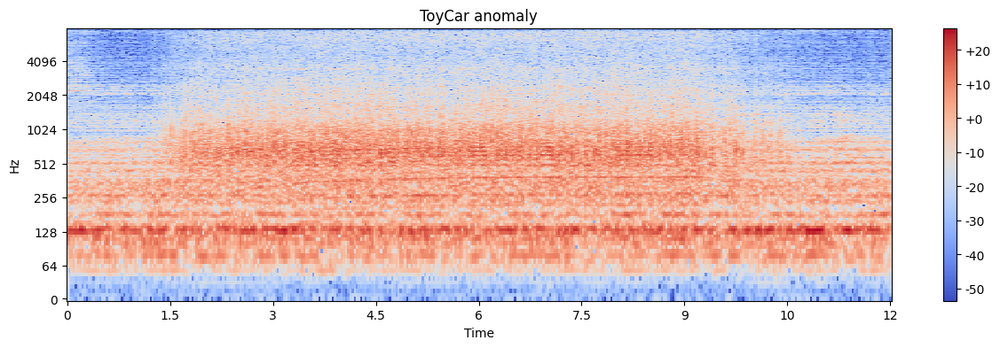

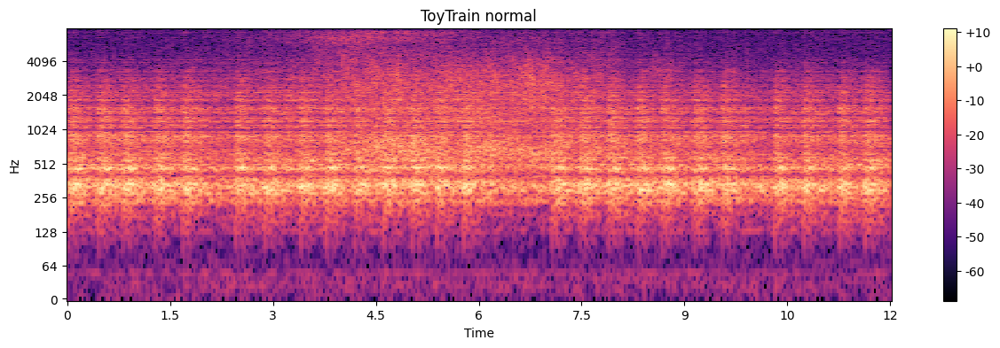

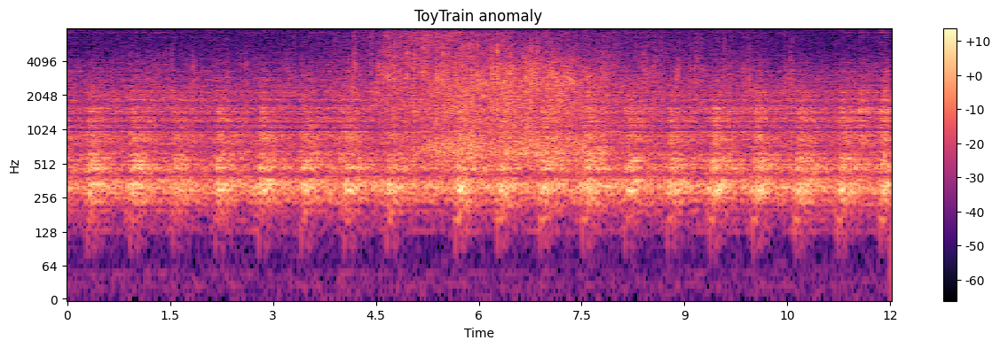

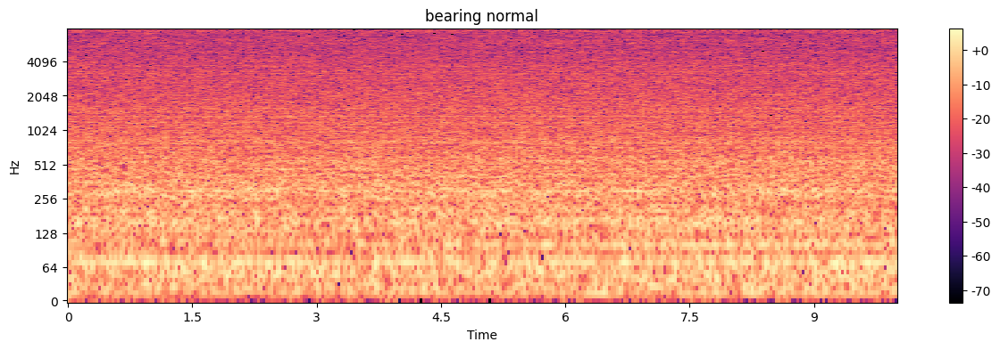

...

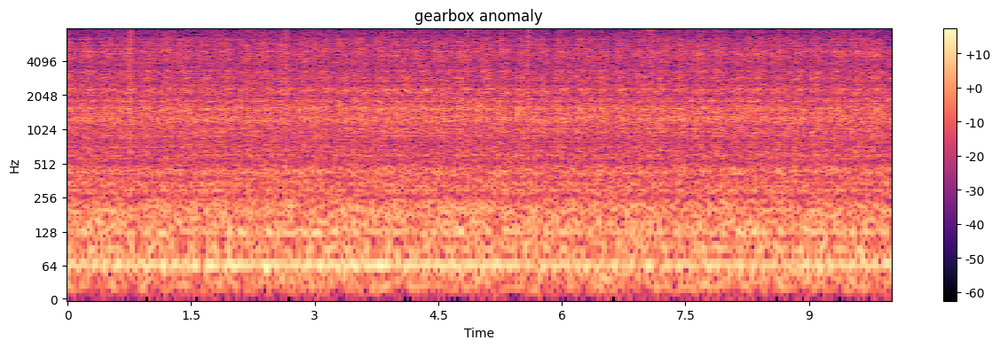

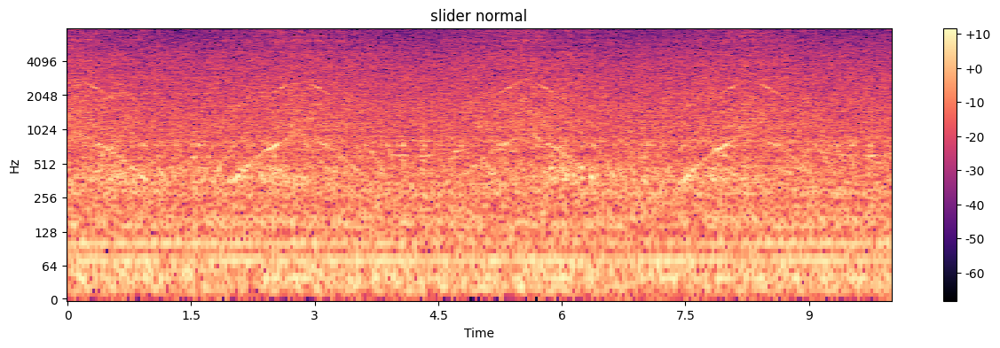

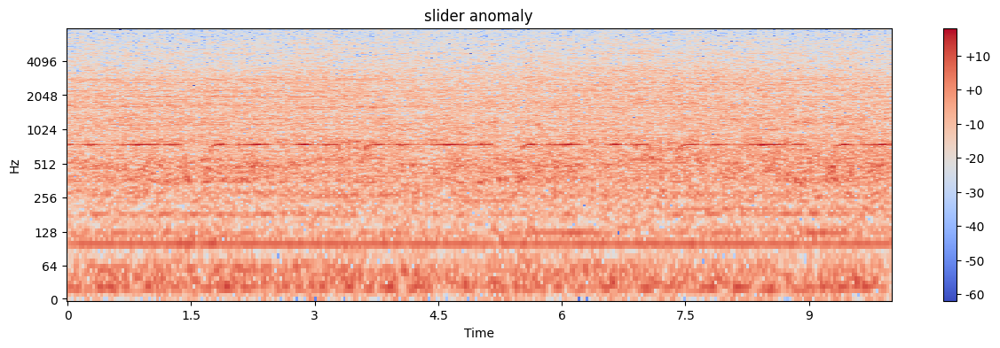

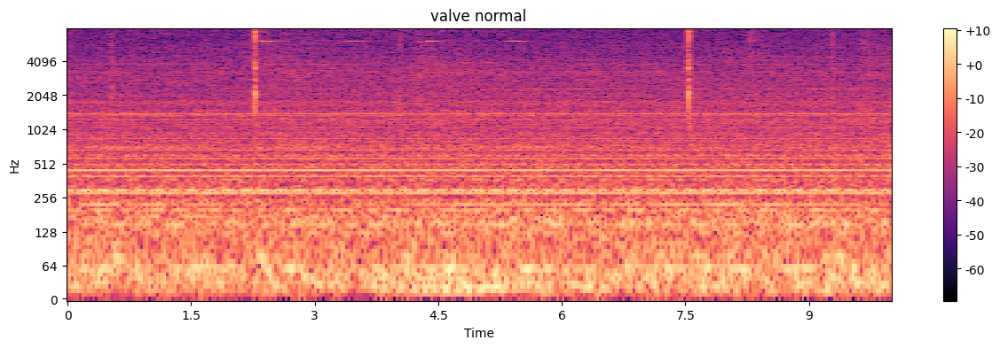

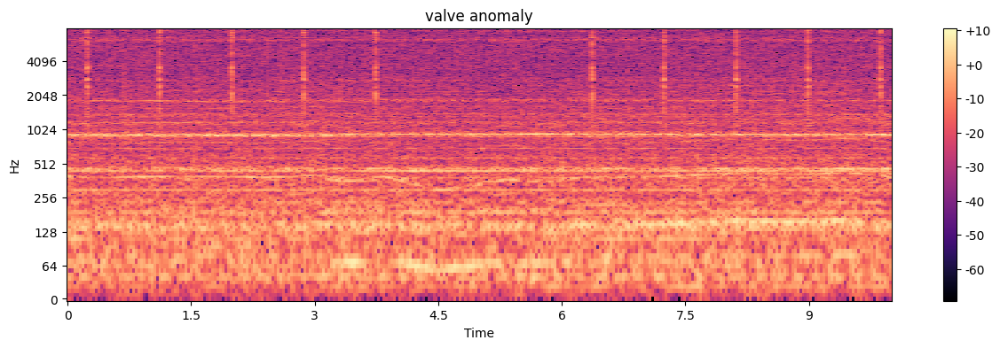

In [ ]:
#log frequency spectrogram
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = log_amp_spec(ran_files[i])
    title = (ran_files[i].split('/'))[0] + " normal"
    plot_spectrogram(Y, sr, HOP_SIZE,y_axis="log")
    plt.title(title)

    plt.figure(figsize=(15,4))
    Y, sr = log_amp_spec(ran_files[i + 7])
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    plot_spectrogram(Y, sr, HOP_SIZE,y_axis="log")
    plt.title(title)
plt.show()
plt.close()

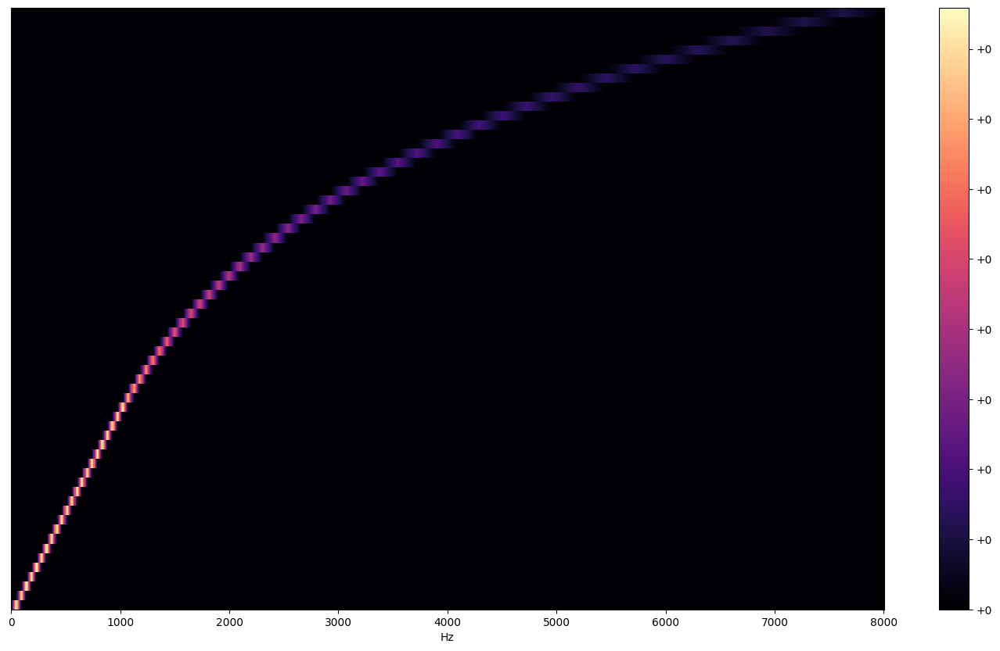

In [ ]:
#Mel filter banks
filter_banks = librosa.filters.mel(n_fft=FRAME_SIZE,sr=16000,n_mels=64)
plt.figure(figsize=(18,10))
librosa.display.specshow(filter_banks,sr=16000,x_axis="linear")
plt.colorbar(format="%+2.f")
plt.show()


In [ ]:
#mel spectrogram
def mel_spec(x):
    signal,sr = librosa.load((os.path.join('development',x)),sr=None)
    spec = librosa.feature.melspectrogram(y=signal,sr=sr,n_fft = FRAME_SIZE,hop_length=HOP_SIZE,n_mels=64)
    spec = librosa.power_to_db(spec)
    return spec,sr

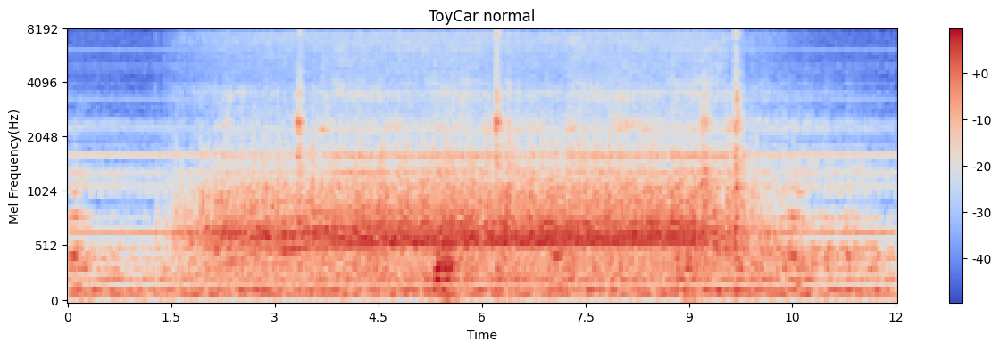

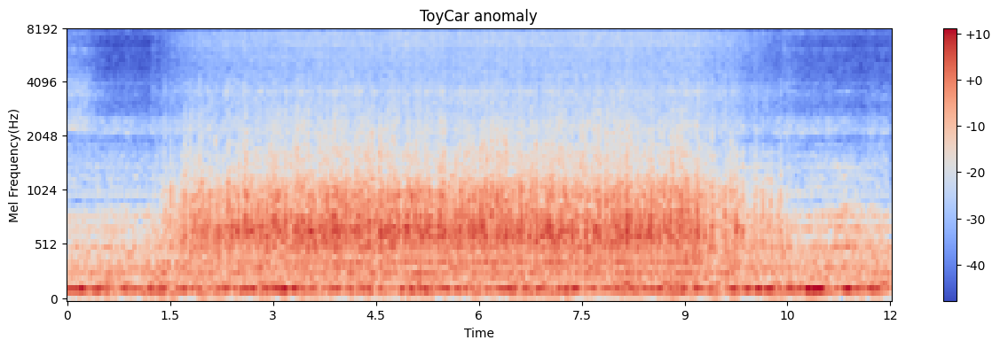

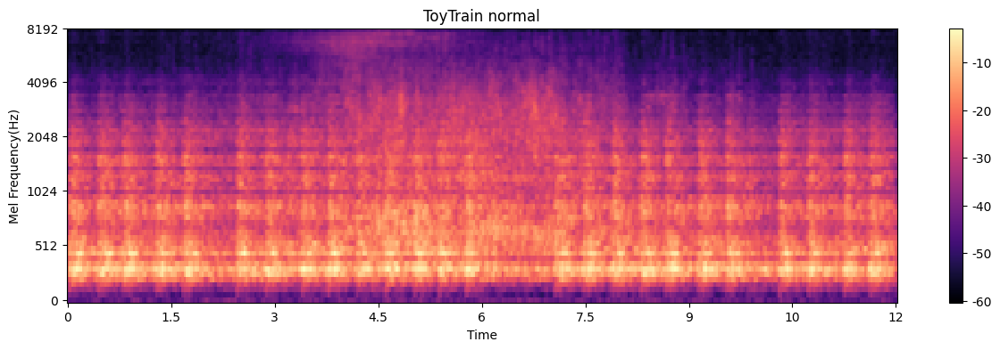

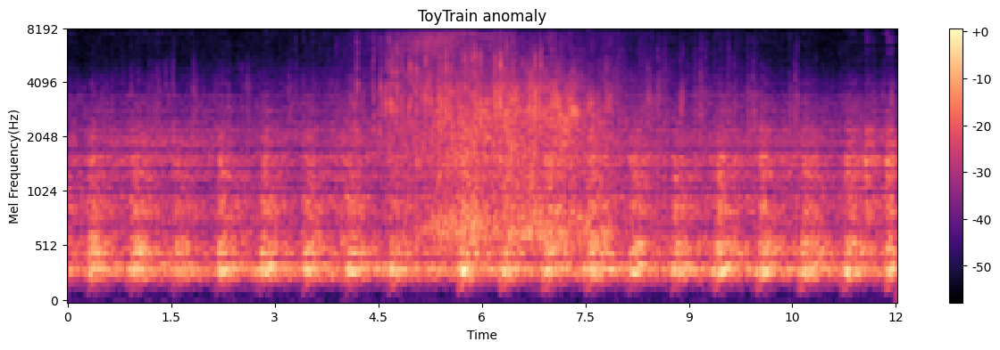

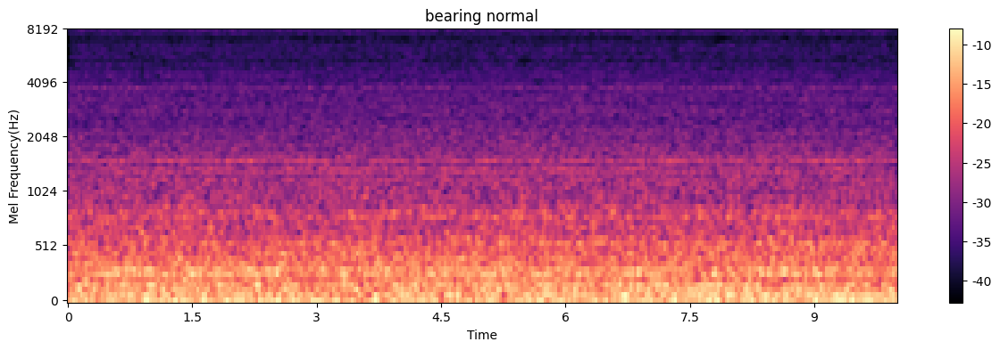

...

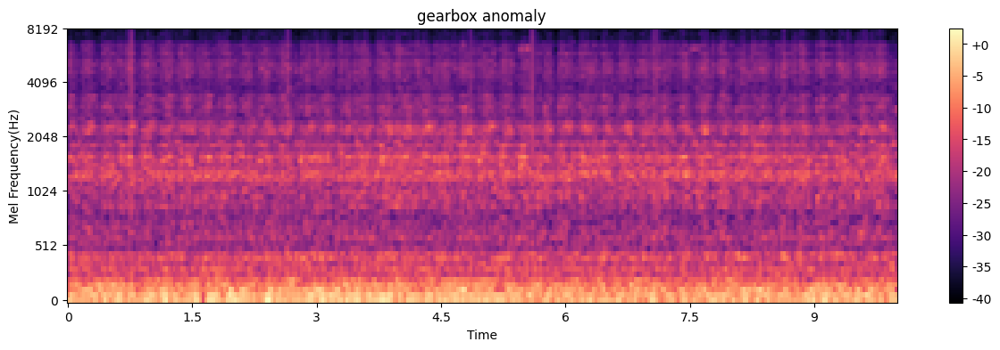

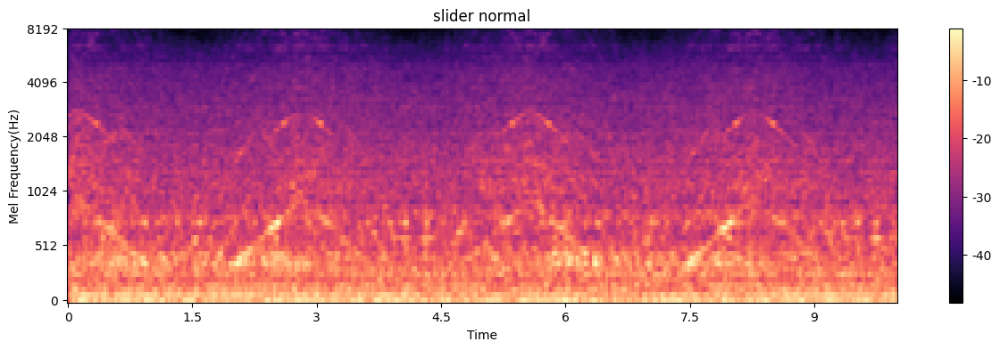

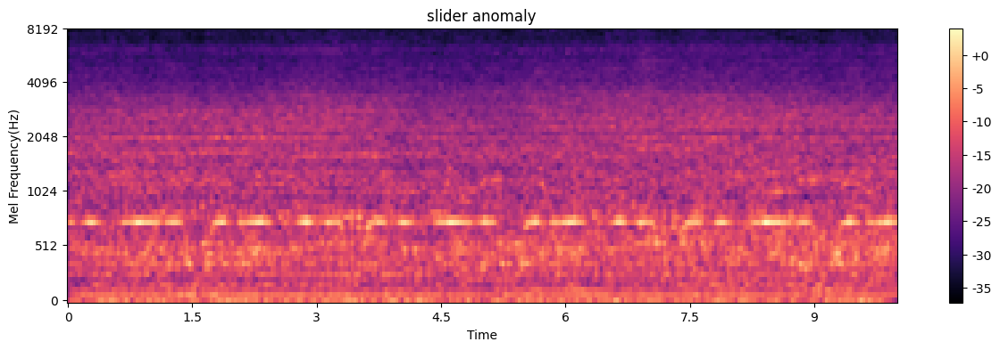

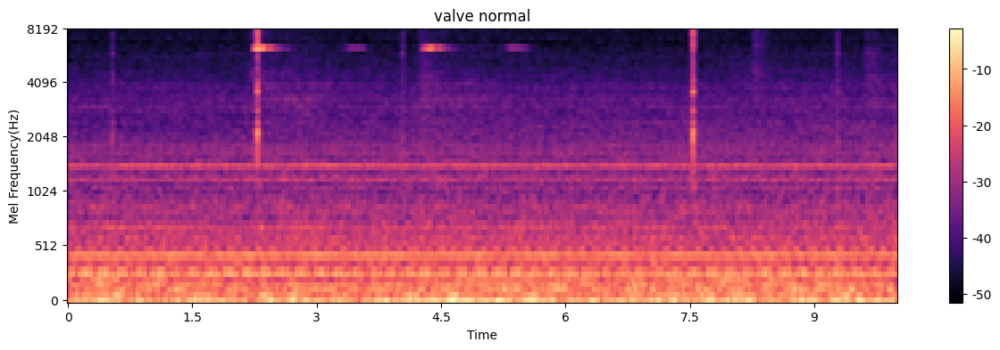

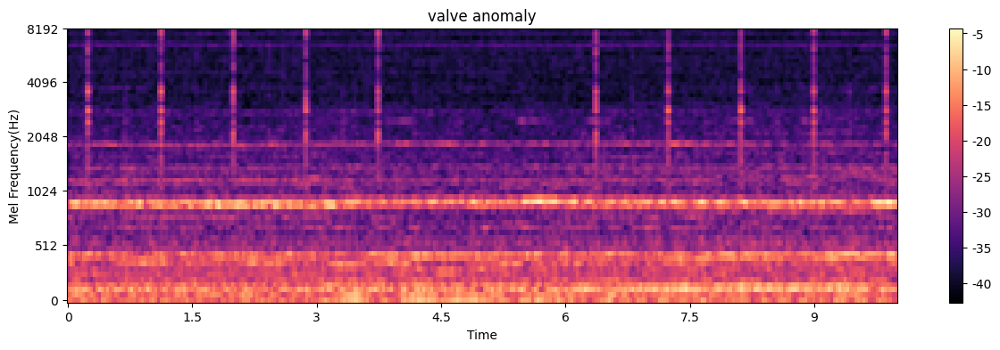

In [ ]:
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = mel_spec(ran_files[i])
    title = (ran_files[i].split('/'))[0] + " normal"
    plot_spectrogram(Y, sr, HOP_SIZE,y_axis="mel")
    plt.title(title)
    plt.ylabel("Mel Frequency(Hz)")

    plt.figure(figsize=(15,4))
    Y, sr = mel_spec(ran_files[i + 7])
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    plot_spectrogram(Y, sr, HOP_SIZE,y_axis="mel")
    plt.title(title)
    plt.ylabel("Mel Frequency(Hz)")
plt.show()
plt.close()

In [ ]:
Y, sr = mel_spec(ran_files[0])

In [ ]:
Y.shape

(64, 376)

In [ ]:
#mel frequency cepstral coefficients
def mfccs(x):
    signal,sr = librosa.load((os.path.join('development',x)),sr=None)
    mfccs = librosa.feature.mfcc(y=signal,sr=sr,n_mfcc=13,n_fft=FRAME_SIZE,hop_length=HOP_SIZE)
    return mfccs,sr

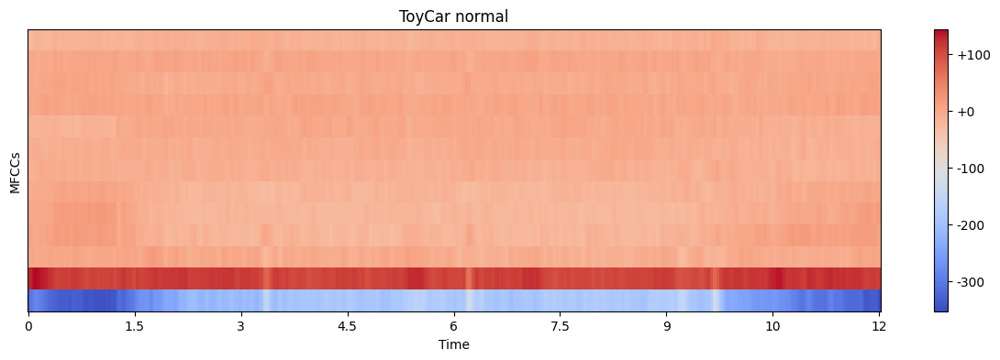

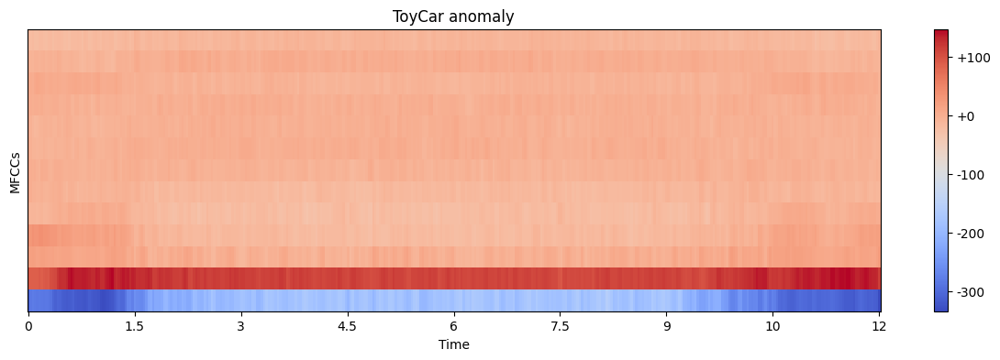

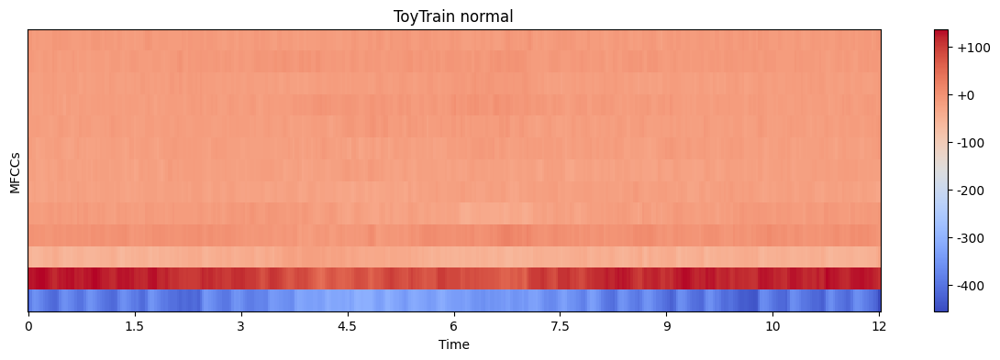

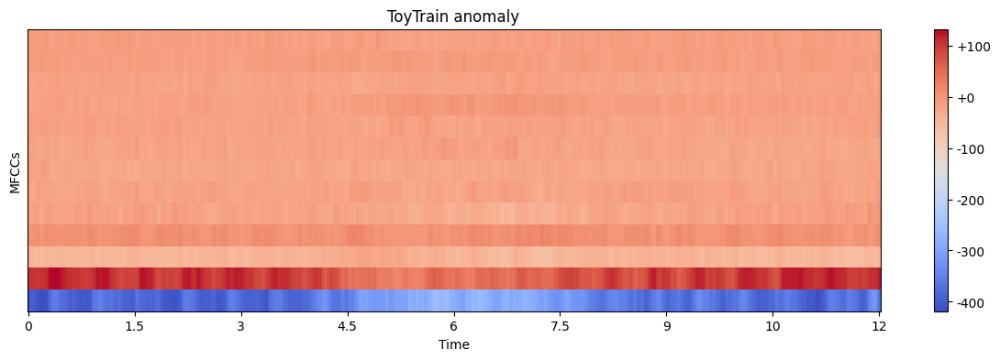

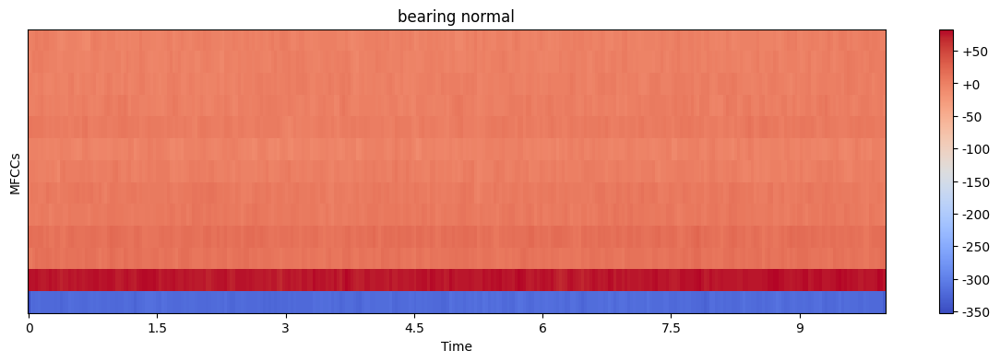

...

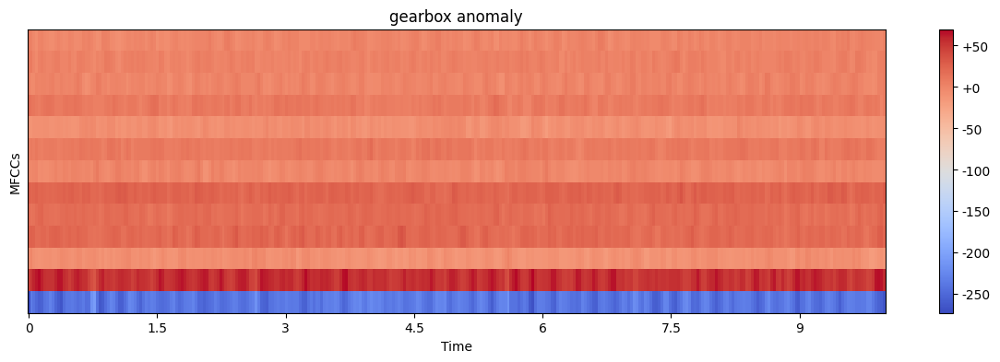

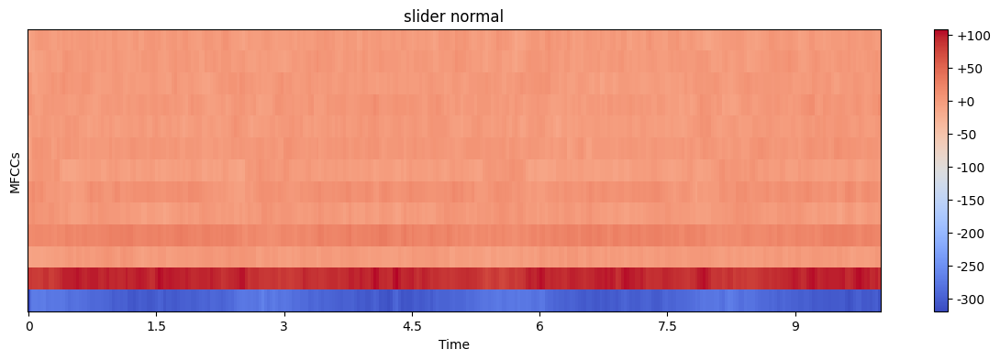

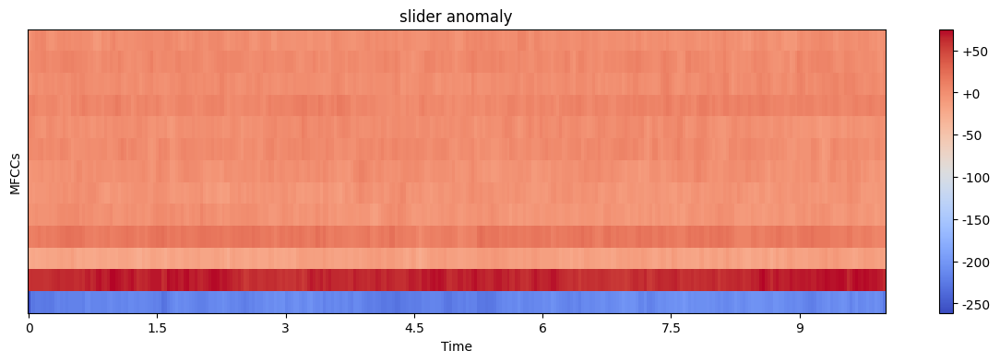

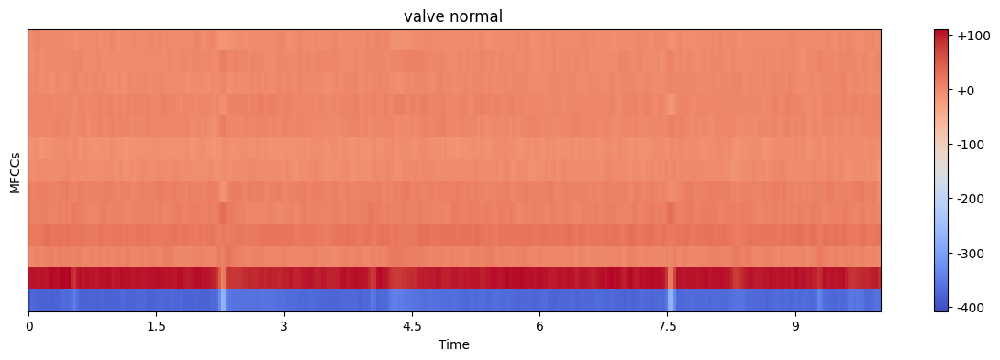

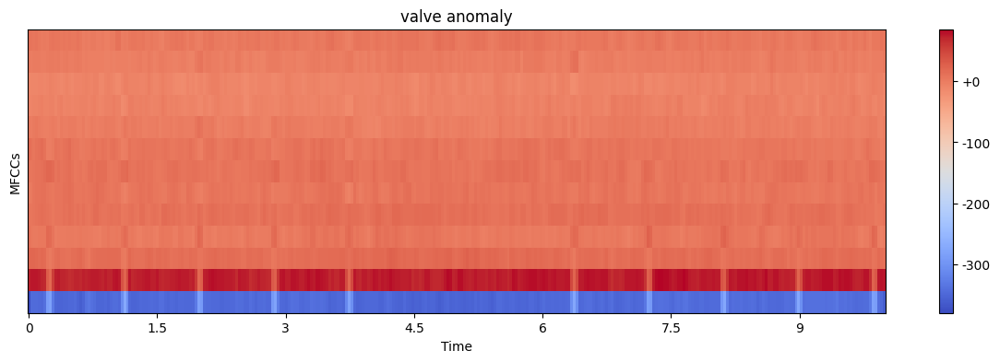

In [ ]:
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = mfccs(ran_files[i])
    title = (ran_files[i].split('/'))[0] + " normal"
    librosa.display.specshow(Y,x_axis="time",sr=sr,hop_length=HOP_SIZE)
    plt.colorbar(format="%+2.f")
    plt.title(title)
    plt.ylabel("MFCCs")

    plt.figure(figsize=(15,4))
    Y, sr = mfccs(ran_files[i + 7])
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    librosa.display.specshow(Y,x_axis="time",sr=sr,hop_length=HOP_SIZE)
    plt.colorbar(format="%+2.f")
    plt.title(title)
    plt.ylabel("MFCCs")
plt.show()
plt.close()

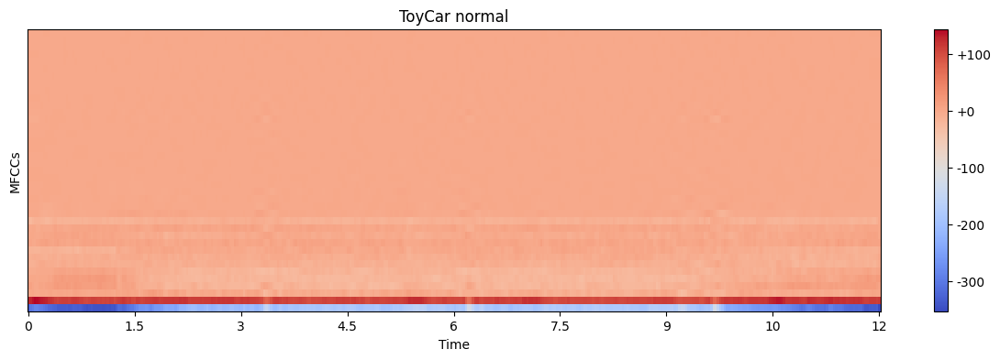

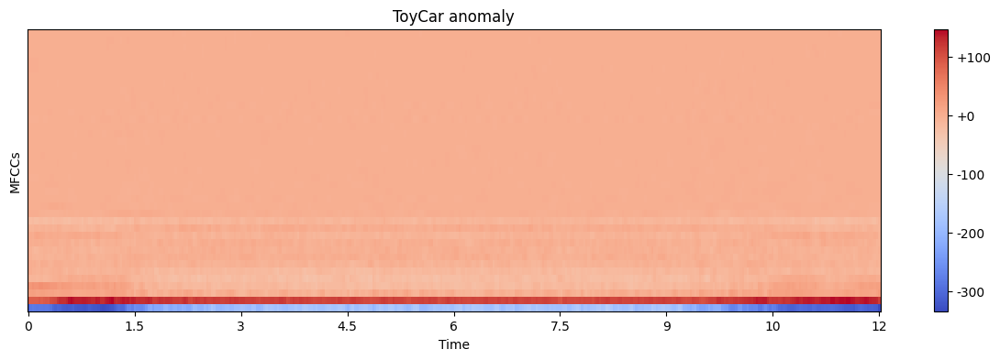

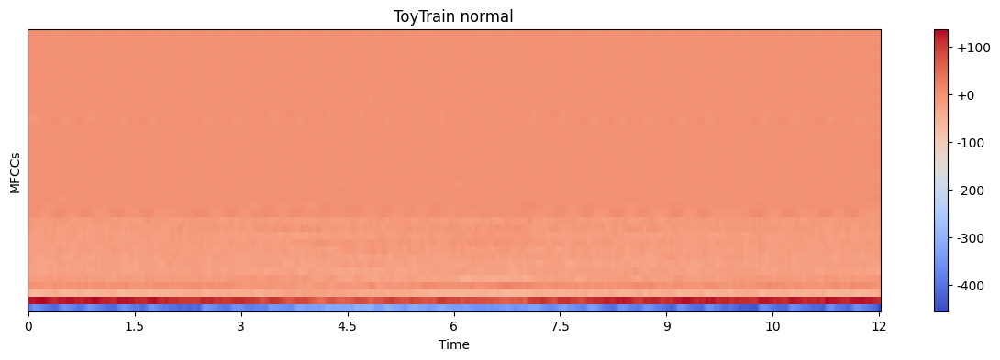

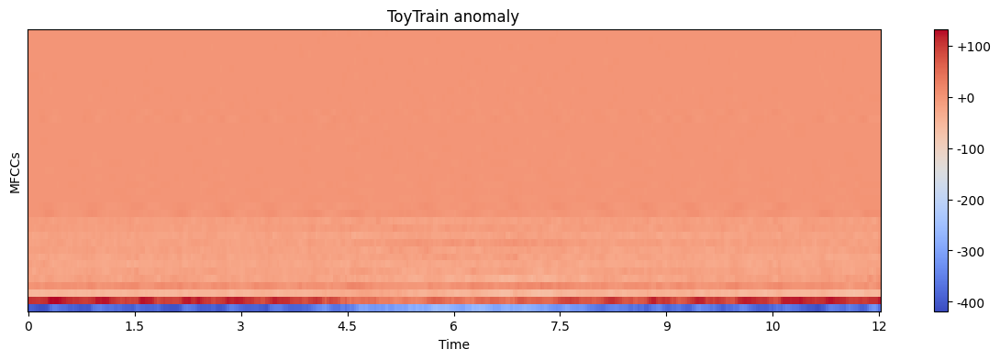

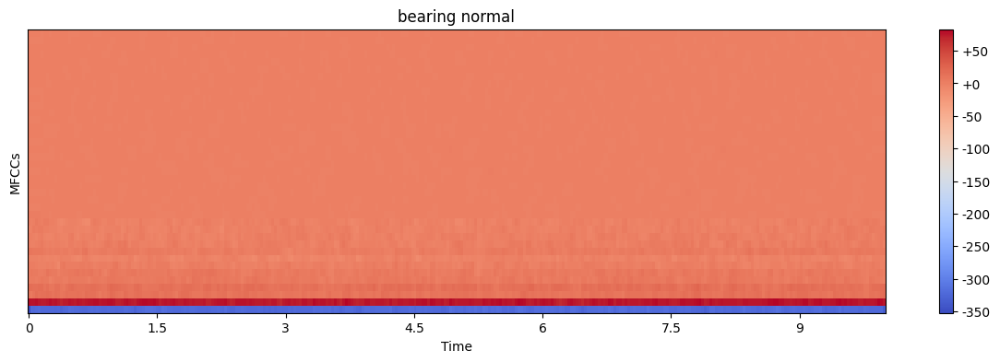

...

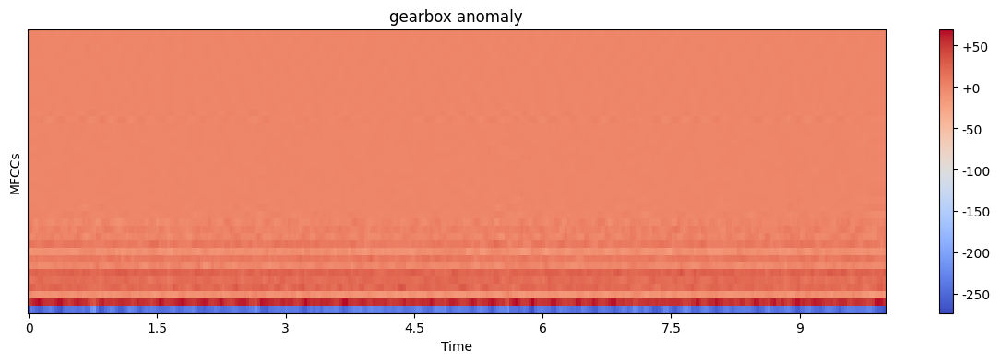

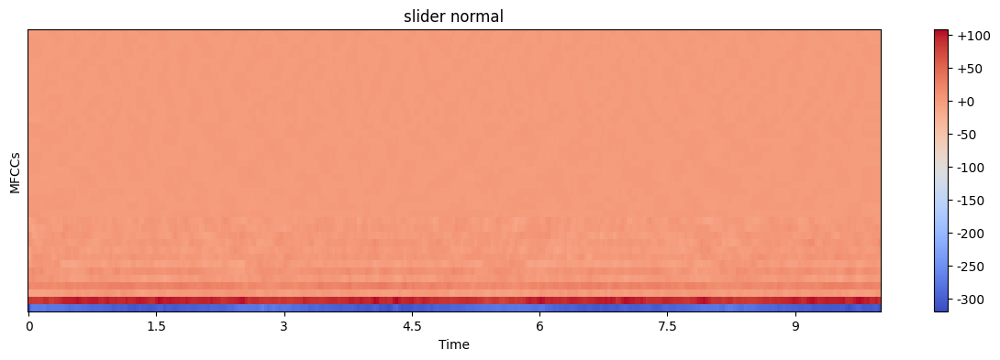

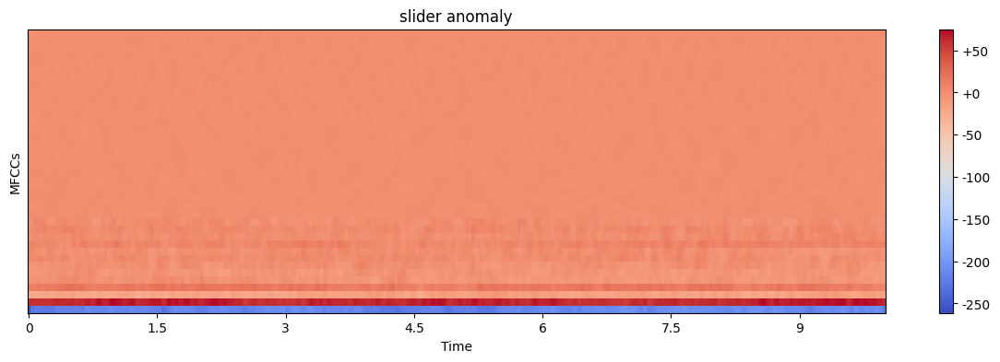

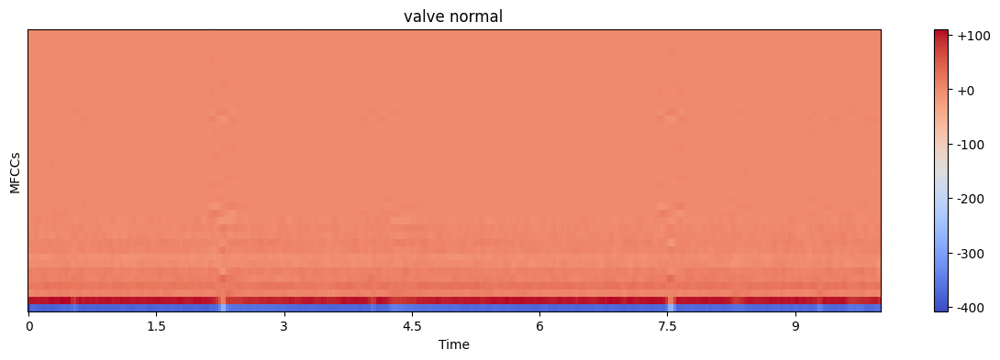

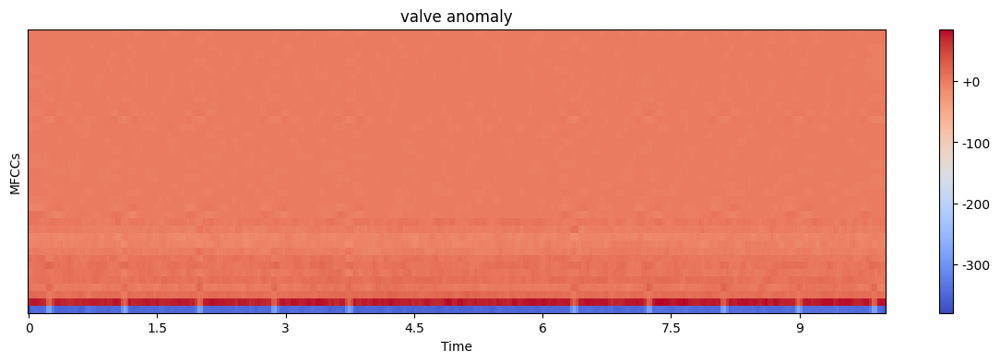

In [ ]:
# mfccs + delta mfccs + delta2_mfccs
for i in range(7):
    plt.figure(figsize=(15,4))
    Y, sr = mfccs(ran_files[i])
    delta=librosa.feature.delta(Y)
    delta2=librosa.feature.delta(Y,order=2)
    Y = np.concatenate((Y,delta,delta2))
    title = (ran_files[i].split('/'))[0] + " normal"
    librosa.display.specshow(Y,x_axis="time",sr=sr,hop_length=HOP_SIZE)
    plt.colorbar(format="%+2.f")
    plt.title(title)
    plt.ylabel("MFCCs")

    plt.figure(figsize=(15,4))
    Y, sr = mfccs(ran_files[i + 7])
    delta=librosa.feature.delta(Y)
    delta2=librosa.feature.delta(Y,order=2)
    Y = np.concatenate((Y,delta,delta2))
    title = (ran_files[i + 7].split('/'))[0] + " anomaly"
    librosa.display.specshow(Y,x_axis="time",sr=sr,hop_length=HOP_SIZE)
    plt.colorbar(format="%+2.f")
    plt.title(title)
    plt.ylabel("MFCCs")
plt.show()
plt.close()

In [ ]:
#train_attributes['log-spec'] = train_attributes['file_name'].transform(lambda x:log_spec(x))

In [ ]:
#train_attributes['log-spec']

In [ ]:
#train_attributes['log-spec'][1].shape

In [ ]:
#train_attributes['log-spec'][1050].shape

<h3><em>Autoencoder model</em></h3>